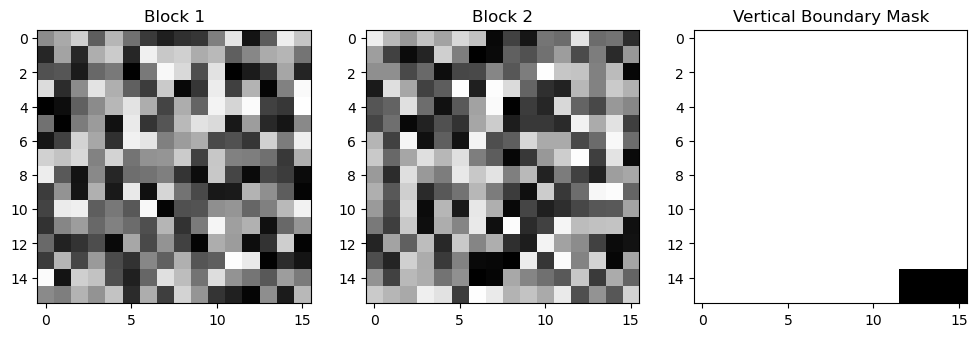

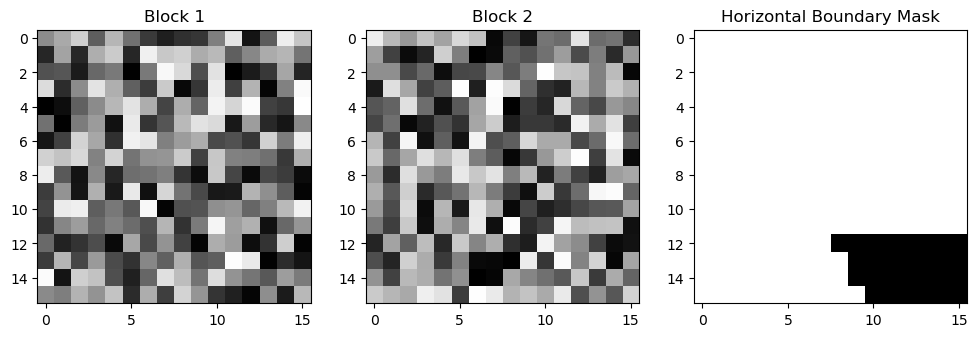

In [6]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from typing import Tuple, Optional
from scipy import ndimage
def visualize_progress(synthesized, mask, step=0):
    """Visualize the original texture and synthesis progress.
    
    Args:
        synthesized: Current state of synthesized texture
        mask: Binary mask showing filled pixels (1 = filled)
        step: Which step is now.
    """
    plt.figure(figsize=(5, 2))
    plt.subplot(121)
    plt.imshow(synthesized, cmap='gray')
    plt.title('Synthesized Texture')
    plt.axis('off')
    
    plt.subplot(122)
    plt.imshow(mask, cmap='gray')
    plt.title("Filled Pixel")
    plt.axis('off')
    plt.suptitle(f"Step {step}", y=0) 
    plt.show()

def load_texture(path: str, size: Optional[Tuple[int, int]] = None) -> np.ndarray:
    """Load a texture image and optionally resize it.
    
    Args:
        path: Path to the image file
        size: Optional tuple of (width, height) to resize the image to
        
    Returns:
        Loaded image as a numpy array with values in [0,1]
    """
    print(path)
    img = cv2.imread(path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    if size:
        img = cv2.resize(img, size)
    plt.imshow(img, cmap='gray')
    plt.axis('off')
    plt.title('Original Texture')
    plt.show()
    return np.array(img) / 255.0

def min_error_boundary(
    block1: np.ndarray,
    block2: np.ndarray,
    overlap_size: int,
    direction: str = 'vertical'  # or 'horizontal'
) -> np.ndarray:
    """
    Compute the minimum error boundary cut between two overlapping blocks using dynamic programming.
    Returns a binary mask where True indicates pixels from block1, False from block2.
    """
    if direction == 'vertical':
        # Vertical overlap: blocks are side by side
        overlap_region1 = block1[:, -overlap_size:]
        overlap_region2 = block2[:, :overlap_size]
        
        # Compute error surface
        error_surface = (overlap_region1 - overlap_region2) ** 2
        
        # Use dynamic programming to find minimum error path
        h, w = error_surface.shape
        cumulative_error = np.zeros_like(error_surface)
        path = np.zeros_like(error_surface, dtype=int)
        
        # Initialize first column
        cumulative_error[:, 0] = error_surface[:, 0]
        
        # Fill cumulative error matrix
        for j in range(1, w):
            for i in range(h):
                # Find minimum error from previous column
                if i == 0:
                    min_idx = np.argmin(cumulative_error[i:i+2, j-1])
                    cumulative_error[i, j] = error_surface[i, j] + cumulative_error[i + min_idx, j-1]
                    path[i, j] = min_idx
                elif i == h - 1:
                    min_idx = np.argmin(cumulative_error[i-1:i+1, j-1])
                    cumulative_error[i, j] = error_surface[i, j] + cumulative_error[i - 1 + min_idx, j-1]
                    path[i, j] = min_idx - 1
                else:
                    min_idx = np.argmin(cumulative_error[i-1:i+2, j-1])
                    cumulative_error[i, j] = error_surface[i, j] + cumulative_error[i - 1 + min_idx, j-1]
                    path[i, j] = min_idx - 1
        
        # Backtrack to find optimal path
        mask = np.ones_like(block1, dtype=bool)
        j = w - 1
        i = np.argmin(cumulative_error[:, -1])
        
        for j in range(w - 1, -1, -1):
            mask[i:, j + block1.shape[1] - overlap_size] = False
            if j > 0:
                i += path[i, j]
        
        return mask
        
    elif direction == 'horizontal':
        # Horizontal overlap: blocks are stacked vertically
        overlap_region1 = block1[-overlap_size:, :]
        overlap_region2 = block2[:overlap_size, :]
        
        # Compute error surface
        error_surface = (overlap_region1 - overlap_region2) ** 2
        
        # Use dynamic programming to find minimum error path
        h, w = error_surface.shape
        cumulative_error = np.zeros_like(error_surface)
        path = np.zeros_like(error_surface, dtype=int)
        
        # Initialize first row
        cumulative_error[0, :] = error_surface[0, :]
        
        # Fill cumulative error matrix
        for i in range(1, h):
            for j in range(w):
                # Find minimum error from previous row
                if j == 0:
                    min_idx = np.argmin(cumulative_error[i-1, j:j+2])
                    cumulative_error[i, j] = error_surface[i, j] + cumulative_error[i-1, j + min_idx]
                    path[i, j] = min_idx
                elif j == w - 1:
                    min_idx = np.argmin(cumulative_error[i-1, j-1:j+1])
                    cumulative_error[i, j] = error_surface[i, j] + cumulative_error[i-1, j - 1 + min_idx]
                    path[i, j] = min_idx - 1
                else:
                    min_idx = np.argmin(cumulative_error[i-1, j-1:j+2])
                    cumulative_error[i, j] = error_surface[i, j] + cumulative_error[i-1, j - 1 + min_idx]
                    path[i, j] = min_idx - 1
        
        # Backtrack to find optimal path
        mask = np.ones_like(block1, dtype=bool)
        i = h - 1
        j = np.argmin(cumulative_error[-1, :])
        
        for i in range(h - 1, -1, -1):
            mask[i + block1.shape[0] - overlap_size, j:] = False
            if i > 0:
                j += path[i, j]
        
        return mask

def find_matching_blocks(source_texture: np.ndarray, 
                        target_overlap: np.ndarray, 
                        block_size: int, 
                        overlap_size: int,
                        direction: str,
                        threshold: float = 0.1) -> list:
    """
    Find blocks in source texture that match the target overlap region.
    """
    h, w = source_texture.shape
    matches = []
    
    # Calculate SSD in overlap region
    for i in range(0, h - block_size + 1):
        for j in range(0, w - block_size + 1):
            source_block = source_texture[i:i+block_size, j:j+block_size]
            
            if direction == 'vertical':
                source_overlap = source_block[:, :overlap_size]
                ssd = np.sum((source_overlap - target_overlap) ** 2)
            else:  # horizontal
                source_overlap = source_block[:overlap_size, :]
                ssd = np.sum((source_overlap - target_overlap) ** 2)
            
            matches.append((i, j, ssd))
    
    # Find best matches within threshold
    if matches:
        min_ssd = min(ssd for _, _, ssd in matches)
        threshold_ssd = min_ssd * (1 + threshold)
        good_matches = [(i, j, ssd) for i, j, ssd in matches if ssd <= threshold_ssd]
        return good_matches
    
    return []

def synthesize_texture_quilting(
    source_texture: np.ndarray,
    output_size: Tuple[int, int],
    block_size: int = 32,
    overlap_size: int = 8,
    threshold: float = 0.1,
    visualize: bool = True
) -> np.ndarray:
    """
    Synthesize texture using Image Quilting algorithm.
    """
    output_h, output_w = output_size
    source_h, source_w = source_texture.shape
    
    # Initialize output texture
    output = np.zeros(output_size)
    mask = np.zeros(output_size, dtype=bool)
    
    # Calculate grid dimensions
    num_blocks_h = (output_h - overlap_size) // (block_size - overlap_size) + 1
    num_blocks_w = (output_w - overlap_size) // (block_size - overlap_size) + 1
    
    # Place first block randomly
    start_i = np.random.randint(0, source_h - block_size + 1)
    start_j = np.random.randint(0, source_w - block_size + 1)
    
    first_block = source_texture[start_i:start_i+block_size, start_j:start_j+block_size]
    output[:block_size, :block_size] = first_block
    mask[:block_size, :block_size] = True
    
    if visualize:
        visualize_progress(output, mask, 0)
    
    # Place remaining blocks
    for row in range(num_blocks_h):
        for col in range(num_blocks_w):
            if row == 0 and col == 0:
                continue  # Skip first block
            
            # Calculate position in output
            i_pos = row * (block_size - overlap_size)
            j_pos = col * (block_size - overlap_size)
            
            # Determine overlap regions
            vertical_overlap = None
            horizontal_overlap = None
            
            if col > 0:  # Has left neighbor
                vertical_overlap = output[i_pos:i_pos+block_size, j_pos:j_pos+overlap_size]
            
            if row > 0:  # Has top neighbor
                horizontal_overlap = output[i_pos:i_pos+overlap_size, j_pos:j_pos+block_size]
            
            # Find matching blocks
            candidates = []
            
            if vertical_overlap is not None and horizontal_overlap is not None:
                # Corner case: both overlaps exist
                for i in range(0, source_h - block_size + 1):
                    for j in range(0, source_w - block_size + 1):
                        block = source_texture[i:i+block_size, j:j+block_size]
                        vert_ssd = np.sum((block[:, :overlap_size] - vertical_overlap) ** 2)
                        horz_ssd = np.sum((block[:overlap_size, :] - horizontal_overlap) ** 2)
                        total_ssd = vert_ssd + horz_ssd
                        candidates.append((i, j, total_ssd))
            
            elif vertical_overlap is not None:
                # Only vertical overlap
                candidates = [(i, j, ssd) for i, j, ssd in 
                             find_matching_blocks(source_texture, vertical_overlap, 
                                                block_size, overlap_size, 'vertical', threshold)]
            
            elif horizontal_overlap is not None:
                # Only horizontal overlap
                candidates = [(i, j, ssd) for i, j, ssd in 
                             find_matching_blocks(source_texture, horizontal_overlap, 
                                                block_size, overlap_size, 'horizontal', threshold)]
            else:
                # No overlaps (shouldn't happen in normal flow)
                i = np.random.randint(0, source_h - block_size + 1)
                j = np.random.randint(0, source_w - block_size + 1)
                candidates = [(i, j, 0)]
            
            # Select random candidate
            if candidates:
                min_ssd = min(ssd for _, _, ssd in candidates)
                threshold_ssd = min_ssd * (1 + threshold)
                good_candidates = [(i, j) for i, j, ssd in candidates if ssd <= threshold_ssd]
                
                if good_candidates:
                    selected_i, selected_j = good_candidates[np.random.randint(len(good_candidates))]
                    new_block = source_texture[selected_i:selected_i+block_size, 
                                             selected_j:selected_j+block_size]
                    
                    # Blend with existing texture using minimum error boundary
                    if vertical_overlap is not None:
                        left_block = output[i_pos:i_pos+block_size, j_pos-overlap_size:j_pos+block_size-overlap_size]
                        mask_vert = min_error_boundary(left_block, new_block, overlap_size, 'vertical')
                        blended_vert = left_block * mask_vert + new_block * (~mask_vert)
                        output[i_pos:i_pos+block_size, j_pos-overlap_size:j_pos+block_size-overlap_size] = blended_vert
                    
                    if horizontal_overlap is not None:
                        top_block = output[i_pos-overlap_size:i_pos+block_size-overlap_size, j_pos:j_pos+block_size]
                        mask_horz = min_error_boundary(top_block, new_block, overlap_size, 'horizontal')
                        blended_horz = top_block * mask_horz + new_block * (~mask_horz)
                        output[i_pos-overlap_size:i_pos+block_size-overlap_size, j_pos:j_pos+block_size] = blended_horz
                    
                    # Place the new block
                    output[i_pos:i_pos+block_size, j_pos:j_pos+block_size] = new_block
                    mask[i_pos:i_pos+block_size, j_pos:j_pos+block_size] = True
            
            if visualize and (row * num_blocks_w + col) % 5 == 0:
                visualize_progress(output, mask, row * num_blocks_w + col)
    
    if visualize:
        visualize_progress(output, mask, num_blocks_h * num_blocks_w)
    
    return output

# Test the min_error_boundary function
def test_min_error_boundary():
    # Create test blocks
    block1 = np.random.rand(16, 16)
    block2 = np.random.rand(16, 16)
    
    # Test vertical boundary
    mask_vert = min_error_boundary(block1, block2, 4, 'vertical')
    
    # Test horizontal boundary
    mask_horz = min_error_boundary(block1, block2, 4, 'horizontal')
    
    # Visualize results
    plt.figure(figsize=(12, 4))
    
    plt.subplot(131)
    plt.imshow(block1, cmap='gray')
    plt.title('Block 1')
    
    plt.subplot(132)
    plt.imshow(block2, cmap='gray')
    plt.title('Block 2')
    
    plt.subplot(133)
    plt.imshow(mask_vert, cmap='gray')
    plt.title('Vertical Boundary Mask')
    
    plt.show()
    
    plt.figure(figsize=(12, 4))
    
    plt.subplot(131)
    plt.imshow(block1, cmap='gray')
    plt.title('Block 1')
    
    plt.subplot(132)
    plt.imshow(block2, cmap='gray')
    plt.title('Block 2')
    
    plt.subplot(133)
    plt.imshow(mask_horz, cmap='gray')
    plt.title('Horizontal Boundary Mask')
    
    plt.show()

# Run test
test_min_error_boundary()

texture3.jpg


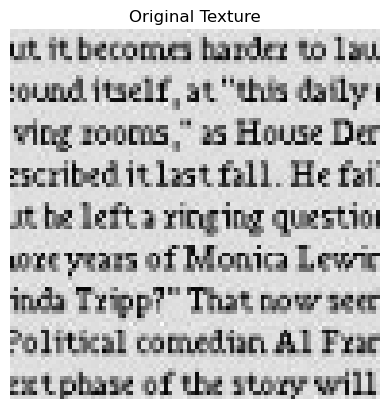

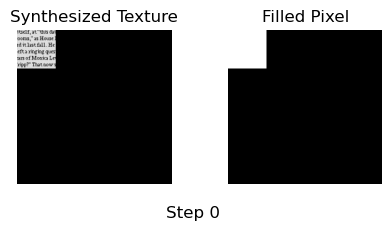

ValueError: operands could not be broadcast together with shapes (64,64) (64,32) 

In [7]:
texture = load_texture("texture3.jpg", (96, 96))
# Synthesize new texture
synthesized = synthesize_texture_quilting(
source_texture=texture,
output_size=(256, 256),
block_size=64,
overlap_size=16,
threshold=0.1
)
# Display results
plt.figure(figsize=(8, 4))
plt.subplot(121)
plt.imshow(texture, cmap='gray')
plt.title('Original Texture')
plt.subplot(122)
plt.imshow(synthesized, cmap='gray')
plt.title('Synthesized Texture')
plt.show()


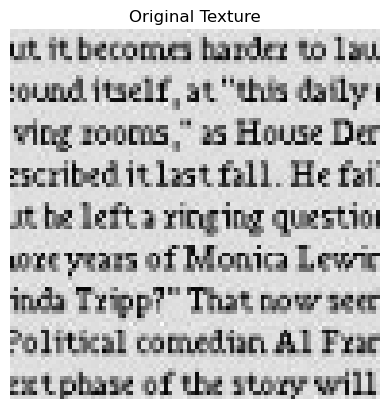

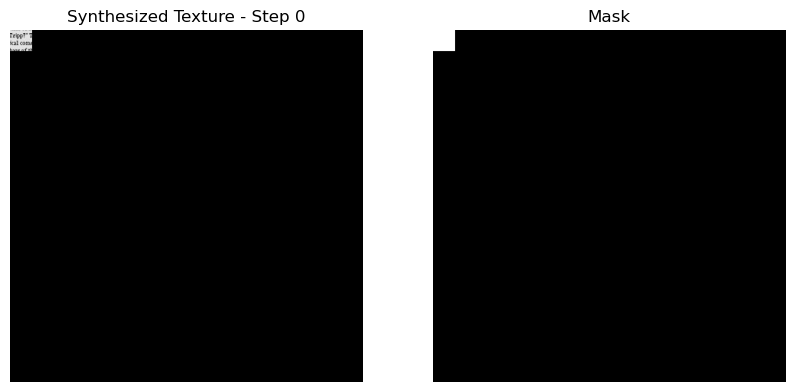

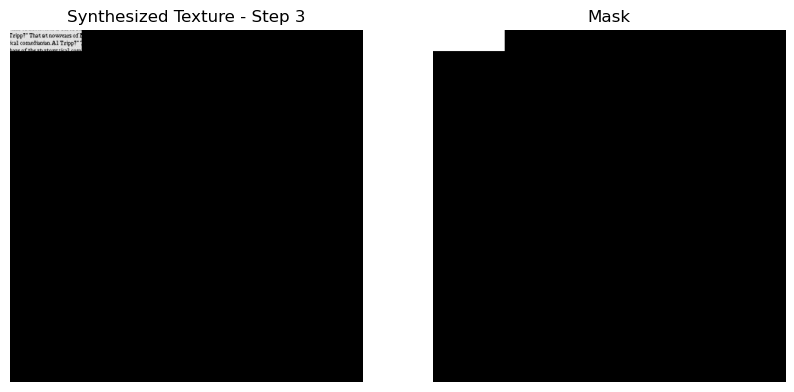

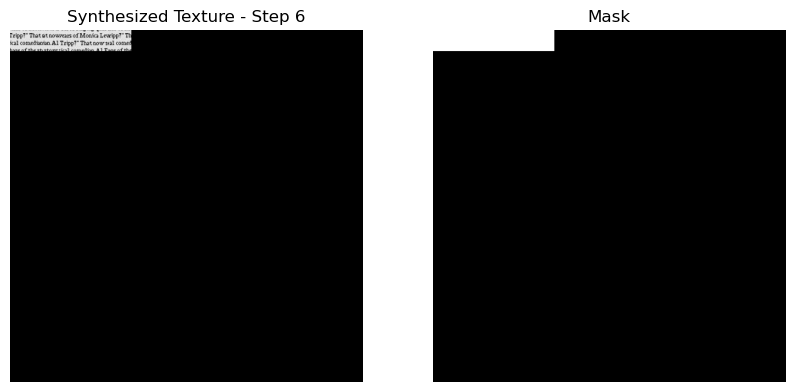

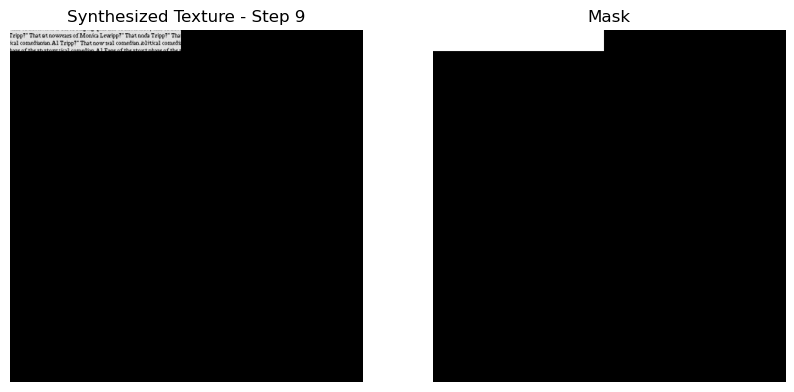

...

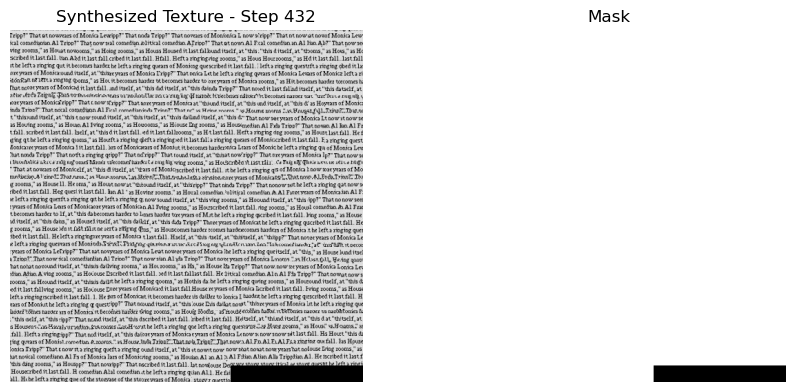

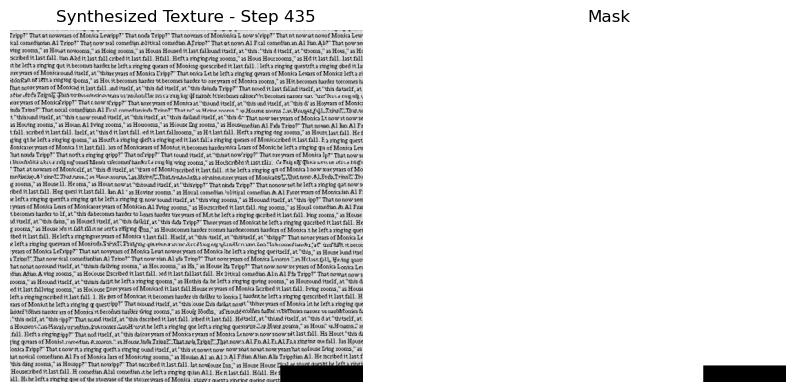

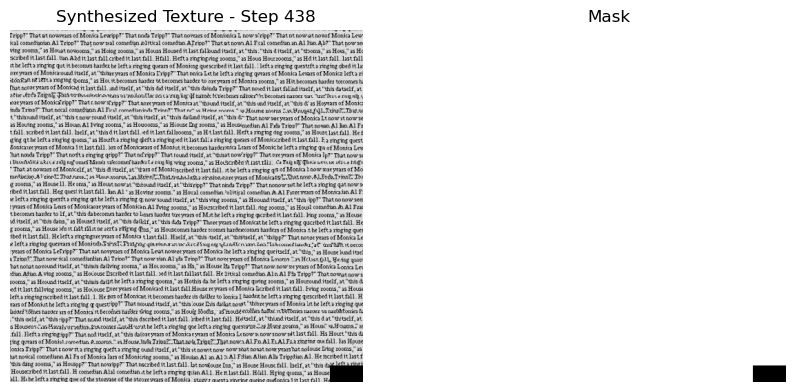

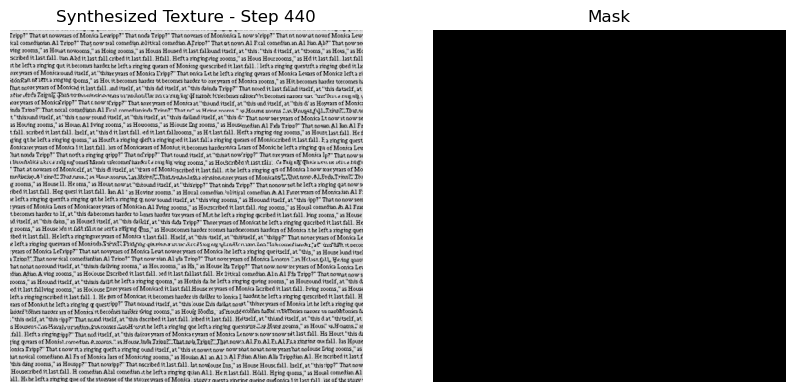

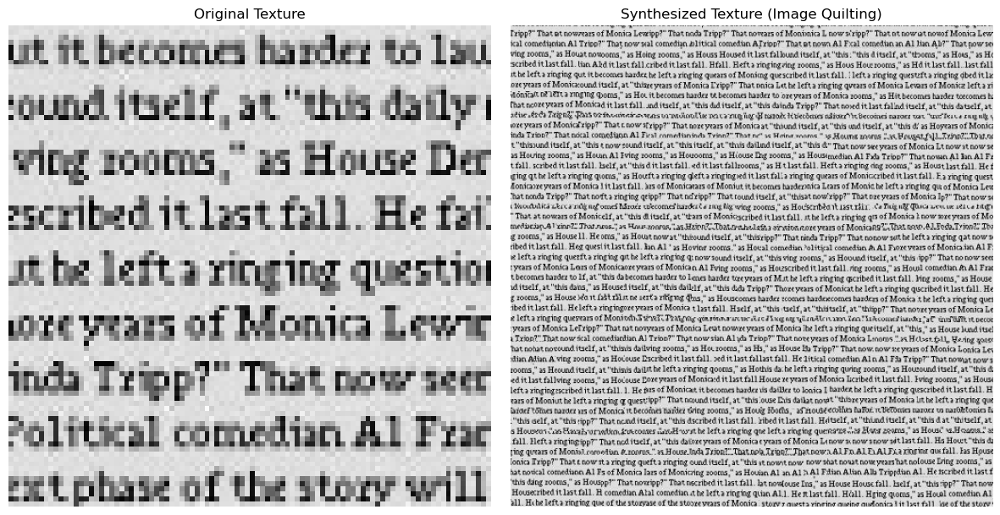

In [10]:
def synthesize_texture_quilting(
    source_texture: np.ndarray,
    output_size: Tuple[int, int],
    block_size: int = 32,
    overlap_size: int = 8,
    threshold: float = 0.1,
    visualize: bool = True
) -> np.ndarray:
    """Main image quilting synthesis function."""
    output_h, output_w = output_size
    source_h, source_w = source_texture.shape
    
    # Initialize output
    output = np.zeros(output_size)
    mask = np.zeros(output_size, dtype=bool)
    
    # Calculate grid size - ensure we don't go out of bounds
    grid_h = (output_h - overlap_size) // (block_size - overlap_size) + 1
    grid_w = (output_w - overlap_size) // (block_size - overlap_size) + 1
    
    # Adjust output size to fit the grid exactly
    actual_output_h = overlap_size + (grid_h - 1) * (block_size - overlap_size) + block_size
    actual_output_w = overlap_size + (grid_w - 1) * (block_size - overlap_size) + block_size
    
    # Ensure we don't exceed requested output size
    actual_output_h = min(actual_output_h, output_h)
    actual_output_w = min(actual_output_w, output_w)
    
    # Place first block randomly
    start_i = np.random.randint(0, source_h - block_size + 1)
    start_j = np.random.randint(0, source_w - block_size + 1)
    
    first_block = source_texture[start_i:start_i+block_size, start_j:start_j+block_size]
    output[:block_size, :block_size] = first_block
    mask[:block_size, :block_size] = True
    
    if visualize:
        visualize_progress(output, mask, 0)
    
    # Place remaining blocks
    block_count = 0
    for row in range(grid_h):
        for col in range(grid_w):
            if row == 0 and col == 0:
                continue
            
            # Calculate position carefully
            pos_i = row * (block_size - overlap_size)
            pos_j = col * (block_size - overlap_size)
            
            # Ensure we don't go out of bounds
            if pos_i + block_size > output_h:
                continue
            if pos_j + block_size > output_w:
                continue
            
            # Get overlap regions
            vert_overlap = None
            horz_overlap = None
            
            if col > 0:
                # Left overlap
                vert_overlap = output[pos_i:pos_i+block_size, pos_j:pos_j+overlap_size]
            
            if row > 0:
                # Top overlap
                horz_overlap = output[pos_i:pos_i+overlap_size, pos_j:pos_j+block_size]
            
            # Find matching blocks
            candidates = []
            
            if vert_overlap is not None and horz_overlap is not None:
                # Both overlaps exist (corner case)
                for i in range(source_h - block_size + 1):
                    for j in range(source_w - block_size + 1):
                        block = source_texture[i:i+block_size, j:j+block_size]
                        vert_error = np.sum((block[:, :overlap_size] - vert_overlap) ** 2)
                        horz_error = np.sum((block[:overlap_size, :] - horz_overlap) ** 2)
                        total_error = vert_error + horz_error
                        candidates.append((i, j, total_error))
            
            elif vert_overlap is not None:
                # Only vertical overlap (left neighbor exists)
                for i in range(source_h - block_size + 1):
                    for j in range(source_w - block_size + 1):
                        block = source_texture[i:i+block_size, j:j+block_size]
                        error = np.sum((block[:, :overlap_size] - vert_overlap) ** 2)
                        candidates.append((i, j, error))
            
            elif horz_overlap is not None:
                # Only horizontal overlap (top neighbor exists)
                for i in range(source_h - block_size + 1):
                    for j in range(source_w - block_size + 1):
                        block = source_texture[i:i+block_size, j:j+block_size]
                        error = np.sum((block[:overlap_size, :] - horz_overlap) ** 2)
                        candidates.append((i, j, error))
            
            else:
                # No overlaps (should only happen for first block)
                i = np.random.randint(0, source_h - block_size + 1)
                j = np.random.randint(0, source_w - block_size + 1)
                candidates = [(i, j, 0)]
            
            # Select and place block
            if candidates:
                # Find minimum error and threshold
                errors = [error for _, _, error in candidates]
                min_error = min(errors)
                threshold_error = min_error * (1 + threshold)
                
                # Get good candidates
                good_candidates = [(i, j) for i, j, error in candidates if error <= threshold_error]
                
                if good_candidates:
                    # Randomly select from good candidates
                    sel_i, sel_j = good_candidates[np.random.randint(len(good_candidates))]
                    new_block = source_texture[sel_i:sel_i+block_size, sel_j:sel_j+block_size]
                    
                    # Place the block
                    output[pos_i:pos_i+block_size, pos_j:pos_j+block_size] = new_block
                    mask[pos_i:pos_i+block_size, pos_j:pos_j+block_size] = True
                    
                    block_count += 1
            
            # Visualize progress
            if visualize and block_count % 3 == 0:
                visualize_progress(output, mask, block_count)
    
    if visualize:
        visualize_progress(output, mask, block_count)
    
    return output

# Test the implementation
try:
    texture = load_texture("texture3.jpg", (96, 96))
except:
    # Create a checkerboard sample texture
    sample_texture = np.zeros((96, 96))
    for i in range(0, 96, 16):
        for j in range(0, 96, 16):
            if (i // 16 + j // 16) % 2 == 0:
                sample_texture[i:i+8, j:j+8] = 0.8
                sample_texture[i+8:i+16, j+8:j+16] = 0.8
            else:
                sample_texture[i:i+8, j+8:j+16] = 0.8
                sample_texture[i+8:i+16, j:j+8] = 0.8
    texture = sample_texture

# Synthesize new texture with smaller parameters for testing
synthesized = synthesize_texture_quilting(
    source_texture=texture,
    output_size=(128*4, 128*4),  # Smaller for testing
    block_size=32,
    overlap_size=8,
    threshold=0.2,  # More tolerant threshold
    visualize=True
)

# Display results
plt.figure(figsize=(12, 6))
plt.subplot(121)
plt.imshow(texture, cmap='gray')
plt.title('Original Texture')
plt.axis('off')

plt.subplot(122)
plt.imshow(synthesized, cmap='gray')
plt.title('Synthesized Texture (Image Quilting)')
plt.axis('off')

plt.tight_layout()
plt.show()